## Demo Faster R-CNN

https://www.learnopencv.com/faster-r-cnn-object-detection-with-pytorch/

In [1]:
from PIL import Image
import matplotlib.pyplot as plt
import torch
import torchvision.transforms as T
import torchvision
import torch
import numpy as np
import cv2

# get the pretrained model from torchvision.models
# Note: pretrained=True will get the pretrained weights for the model.
# model.eval() to use the model for inference
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
model.eval()

# Class labels from official PyTorch documentation for the pretrained model
# Note that there are some N/A's 
# for complete list check https://tech.amikelive.com/node-718/what-object-categories-labels-are-in-coco-dataset/
# we will use the same list for this notebook
COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

In [2]:
def predict_faster(img_path, threshold, gpu):
  img = Image.open(img_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)
  if gpu:
    model.cuda()
    img = img.cuda()
  else:
    model.cpu()
    img = img.cpu()
  # prediction
  pred = model([img])
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].cpu().numpy())]
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].cpu().detach().numpy())]
  pred_score = list(pred[0]['scores'].cpu().detach().numpy())
  pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]
  text_size=1
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  print (len(pred_boxes))
  for i in range(len(pred_boxes)):
    cv2.rectangle(img, pred_boxes[i][0], pred_boxes[i][1],color=(0, 255, 0), thickness=1)
    cv2.putText(img,pred_class[i], pred_boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=1)
  plt.figure(figsize=(20,30))
  plt.imshow(img)
  plt.xticks([])
  plt.yticks([])
  plt.show()

### 2 object

--2020-07-01 08:08:39--  https://truonglaixethegioi.com/wp-content/uploads/2015/08/hoc-lai-xe-o-to-tu-khi-lai-xe-may.jpg
Resolving truonglaixethegioi.com (truonglaixethegioi.com)... 172.96.191.110
Connecting to truonglaixethegioi.com (truonglaixethegioi.com)|172.96.191.110|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 33522 (33K) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>]  32.74K   109KB/s    in 0.3s    

2020-07-01 08:08:40 (109 KB/s) - ‘people.jpg’ saved [33522/33522]



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "
/pytorch/torch/csrc/utils/python_arg_parser.cpp:756: UserWarning: This overload of nonzero is deprecated:
	nonzero(Tensor input, *, Tensor out)
Consider using one of the following signatures instead:
	nonzero(Tensor input, *, bool as_tuple)


2


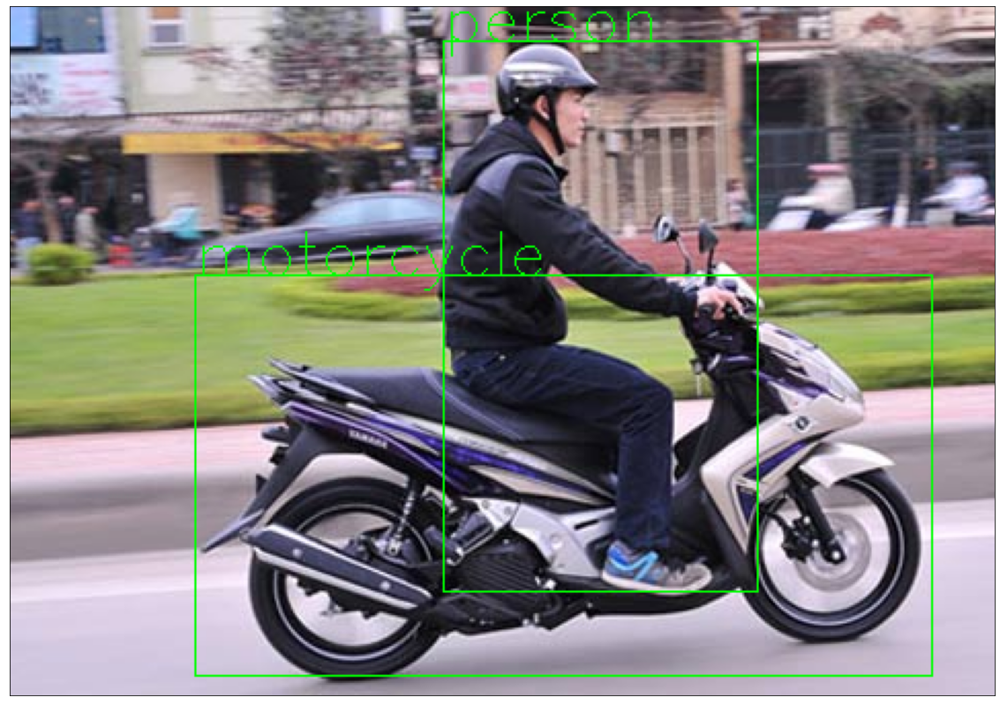

Total run-time: 3475.208759 ms


In [3]:
# download an image for inference
!wget https://truonglaixethegioi.com/wp-content/uploads/2015/08/hoc-lai-xe-o-to-tu-khi-lai-xe-may.jpg -O people.jpg

# use the api pipeline for object detection
# the threshold is set manually, the model sometimes predict 
# random structures as some object, so we set a threshold to filter
# better prediction scores.
import time
start_time = time.time()
predict_faster('./people.jpg', threshold=0.99, gpu = True)
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

### 4 object

--2020-07-01 08:09:10--  https://i.a4vn.com/2019/4/27/sinh-vien-ngoai-giao-dua-nhau-khong-di-xe-may-den-truong-ma-di-x-df046f.jpg
Resolving i.a4vn.com (i.a4vn.com)... 123.30.139.27, 123.30.139.26, 123.30.139.42
Connecting to i.a4vn.com (i.a4vn.com)|123.30.139.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 116664 (114K) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>] 113.93K   126KB/s    in 0.9s    

2020-07-01 08:09:13 (126 KB/s) - ‘people.jpg’ saved [116664/116664]



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


3


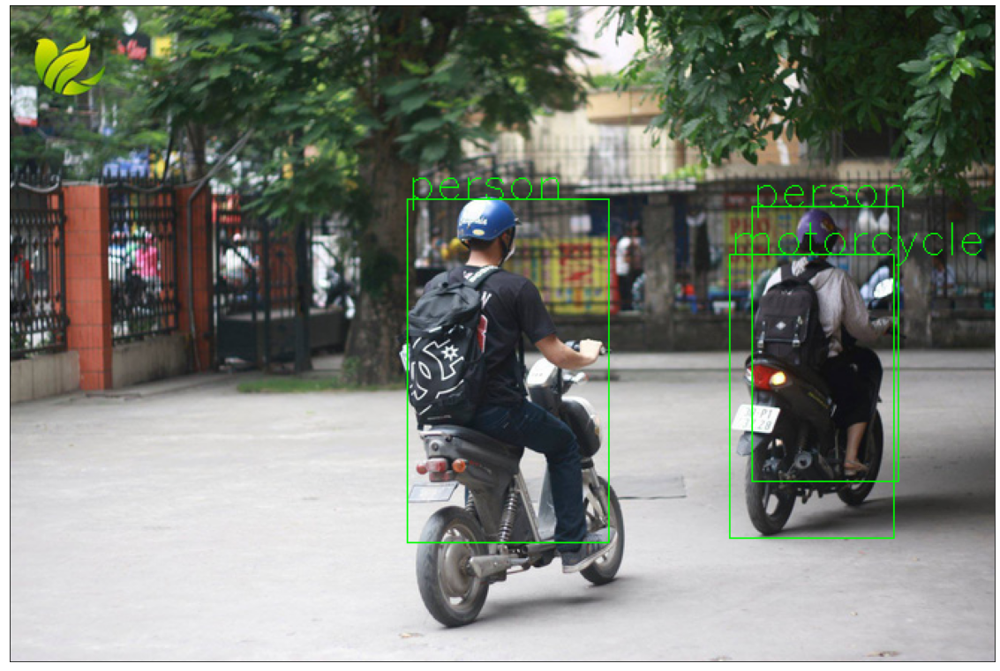

Total run-time: 778.364420 ms


In [4]:
# download an image for inference
!wget https://i.a4vn.com/2019/4/27/sinh-vien-ngoai-giao-dua-nhau-khong-di-xe-may-den-truong-ma-di-x-df046f.jpg -O people.jpg

# use the api pipeline for object detection
# the threshold is set manually, the model sometimes predict 
# random structures as some object, so we set a threshold to filter
# better prediction scores.
import time
start_time = time.time()
predict_faster('./people.jpg', threshold=0.99, gpu = True)
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

### Over 10 object

--2020-07-01 08:10:03--  http://www.baodongnai.com.vn/dataimages/201803/original/images2111009_6E.jpg
Resolving www.baodongnai.com.vn (www.baodongnai.com.vn)... 123.31.45.45
Connecting to www.baodongnai.com.vn (www.baodongnai.com.vn)|123.31.45.45|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 144775 (141K) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>] 141.38K   156KB/s    in 0.9s    

2020-07-01 08:10:04 (156 KB/s) - ‘people.jpg’ saved [144775/144775]



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


5


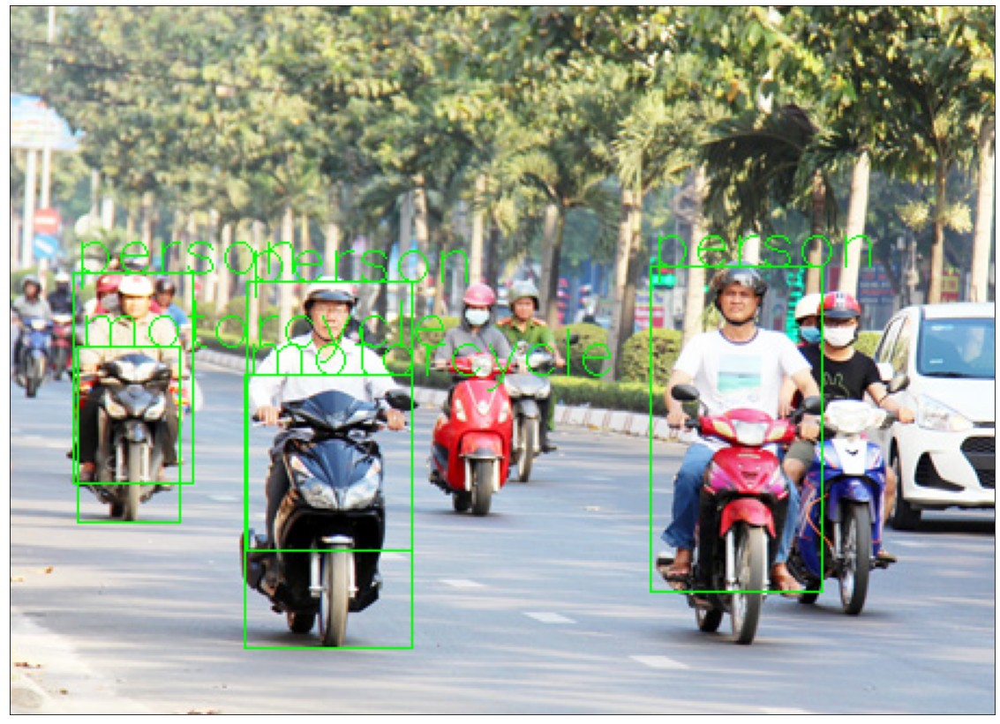

Total run-time: 842.340469 ms


In [5]:
# download an image for inference
!wget http://www.baodongnai.com.vn/dataimages/201803/original/images2111009_6E.jpg -O people.jpg

# use the api pipeline for object detection
# the threshold is set manually, the model sometimes predict 
# random structures as some object, so we set a threshold to filter
# better prediction scores.
import time
start_time = time.time()
predict_faster('./people.jpg', threshold=0.99, gpu = True)
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

### On video

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [7]:
cd drive/My Drive/Colab Notebooks/Detection

/content/drive/My Drive/Colab Notebooks/Detection


In [90]:
def predict_faster_video(img, threshold, gpu):
  pil_image=Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  transform = T.Compose([T.ToTensor()])
  pil_image = transform(pil_image)
  if gpu:
    model.cuda()
    pil_image = pil_image.cuda()
  else:
    model.cpu()
    pil_image = pil_image.cpu()
  # prediction
  pred = model([pil_image])
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].cpu().numpy())]
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].cpu().detach().numpy())]
  pred_score = list(pred[0]['scores'].cpu().detach().numpy())
  pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]
  text_size=1
  print (len(pred_boxes))
  for i in range(len(pred_boxes)):
    cv2.rectangle(img, pred_boxes[i][0], pred_boxes[i][1],color=(0, 255, 0), thickness=1)
    cv2.putText(img,pred_class[i], pred_boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=1)
  return img

<class 'numpy.ndarray'>
(360, 640, 3)


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


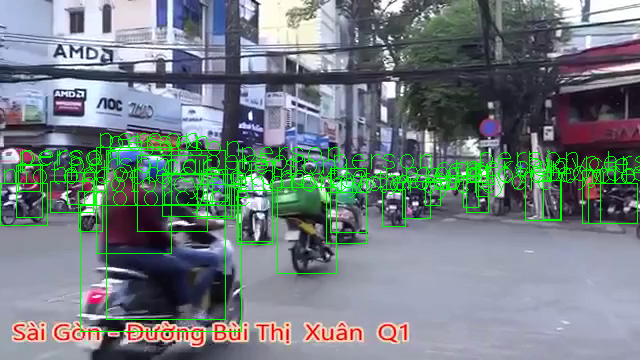

1


In [58]:
from google.colab.patches import cv2_imshow
cap = cv2.VideoCapture('test.mp4')
k = 0
while(k==0):
  ret, frame = cap.read()
  print(type(frame))
  detection = predict_faster_video(frame, threshold=0.5, gpu=True)
  print(detection.shape)
  cv2_imshow(detection)
  k = k+1
  print (k)

In [91]:
VIDEO_STREAM = "/content/drive/My Drive/Colab Notebooks/Detection/test.mp4"
VIDEO_STREAM_OUT = "/content/drive/My Drive/Colab Notebooks/Detection/pre.mp4"

/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


31


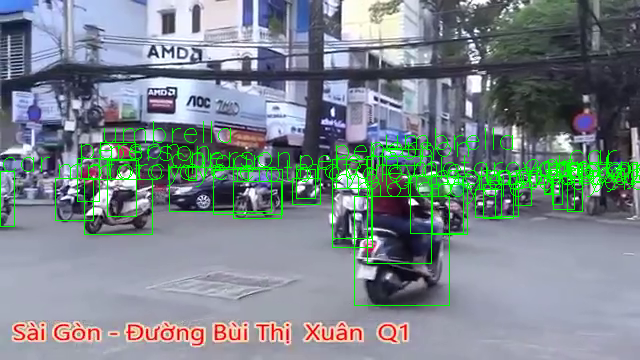

Time on image 0 : 238.650084 ms
30


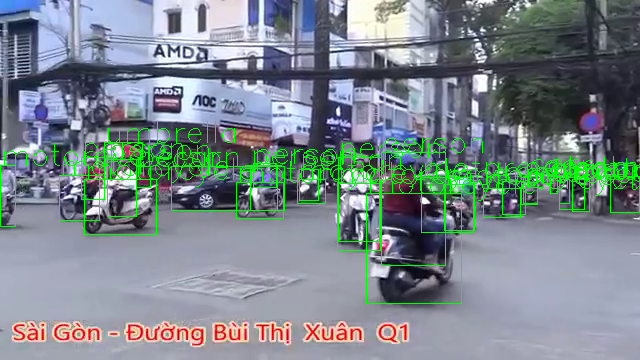

Time on image 1 : 259.647131 ms
27


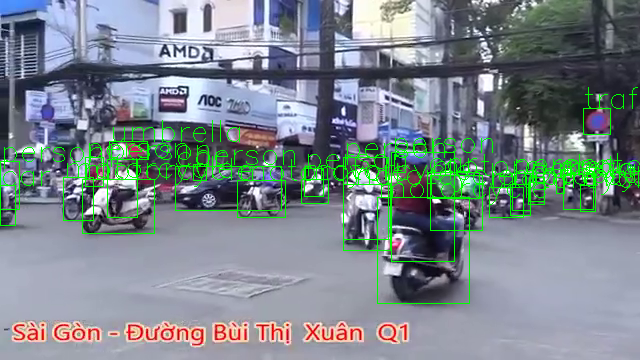

Time on image 2 : 228.026152 ms
32


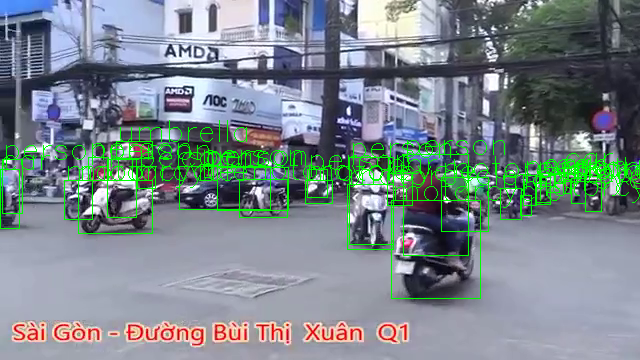

Time on image 3 : 228.814602 ms
32


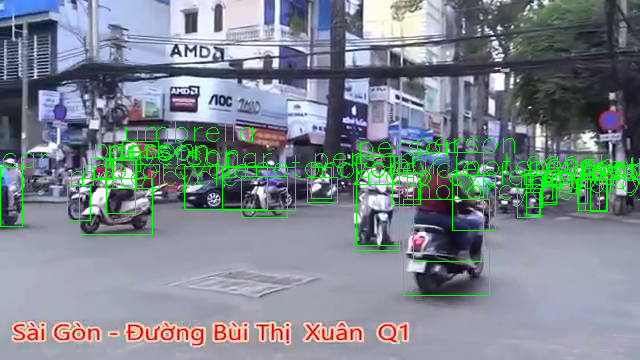

Time on image 4 : 232.540607 ms
34


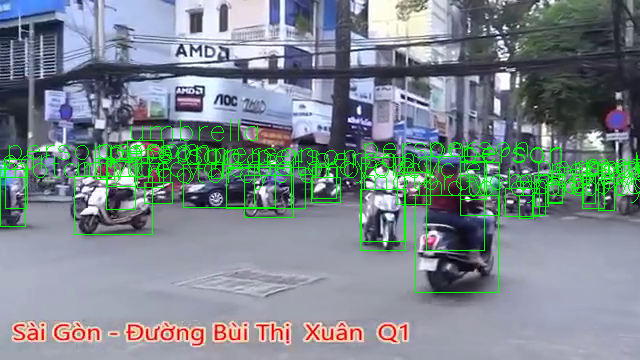

Time on image 5 : 233.623743 ms
30


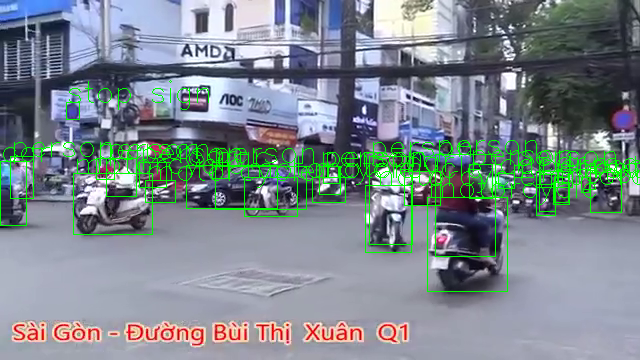

Time on image 6 : 231.037855 ms
31


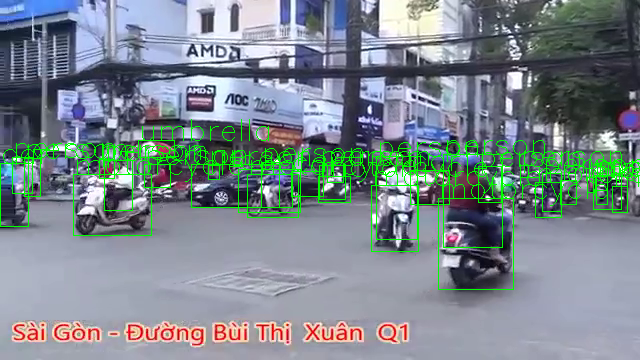

Time on image 7 : 228.843451 ms
31


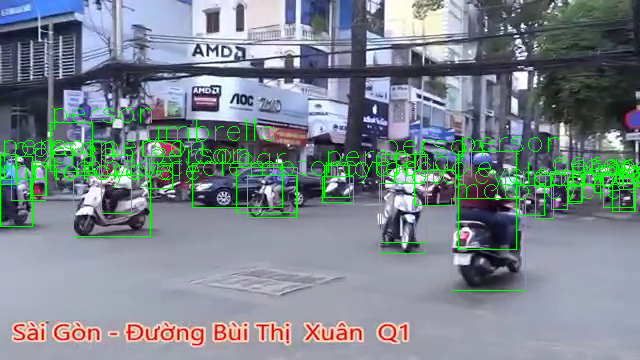

Time on image 8 : 281.908274 ms
29


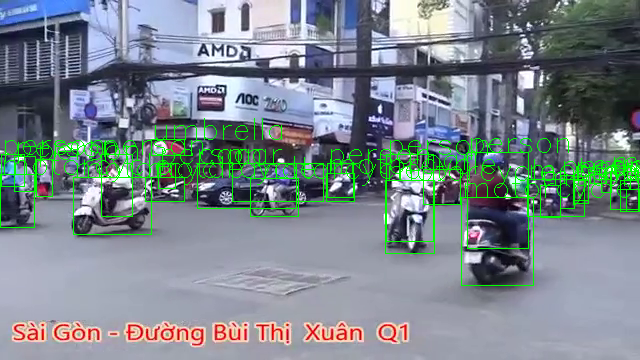

Time on image 9 : 236.525059 ms
27


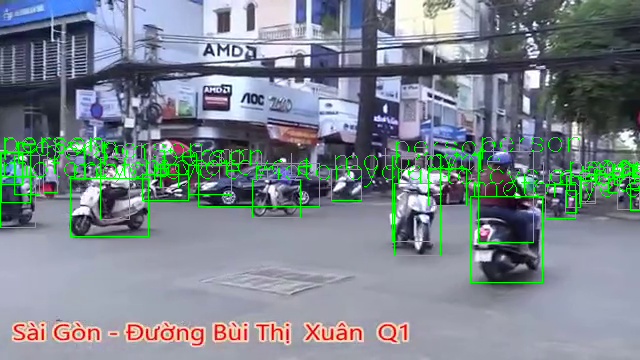

Time on image 10 : 226.533651 ms
32


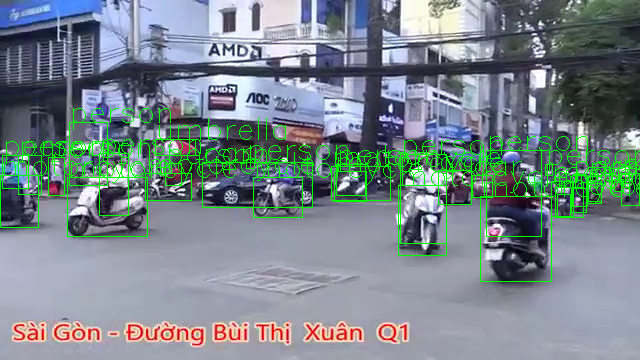

Time on image 11 : 225.752592 ms
29


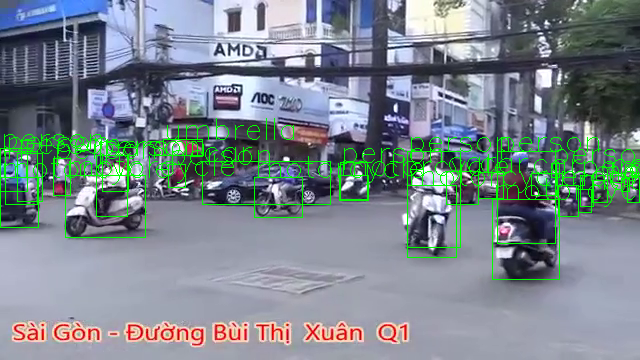

Time on image 12 : 228.676081 ms
27


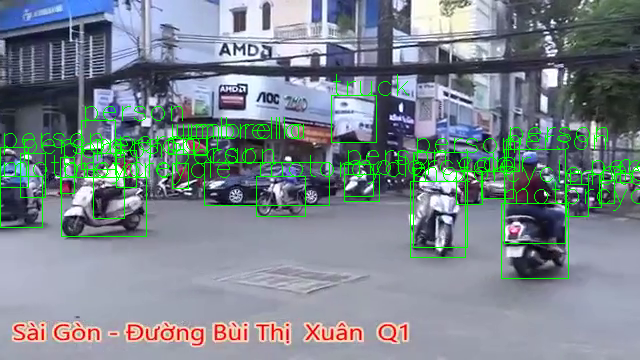

Time on image 13 : 224.872351 ms
32


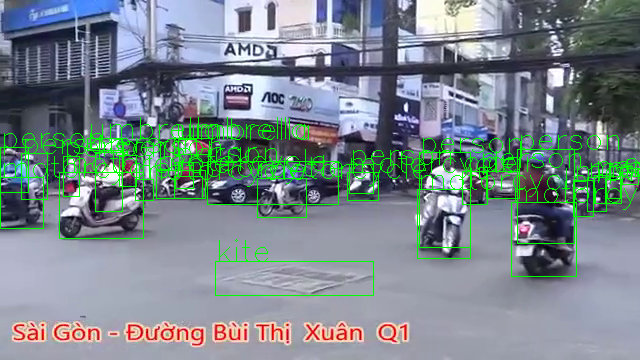

Time on image 14 : 229.913473 ms
29


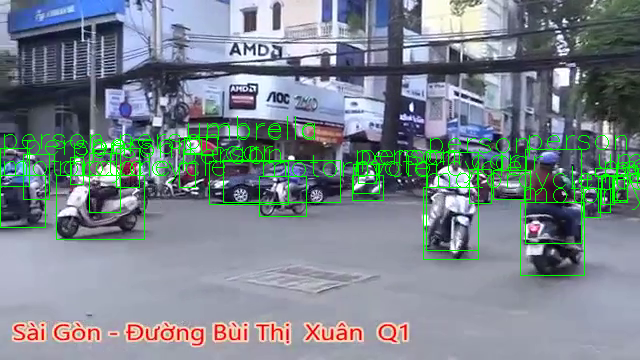

Time on image 15 : 225.666761 ms
25


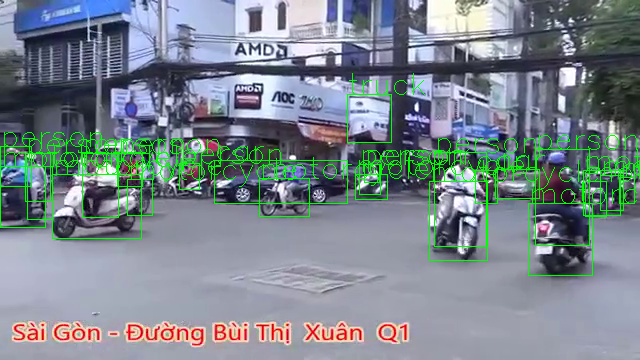

Time on image 16 : 220.504999 ms
25


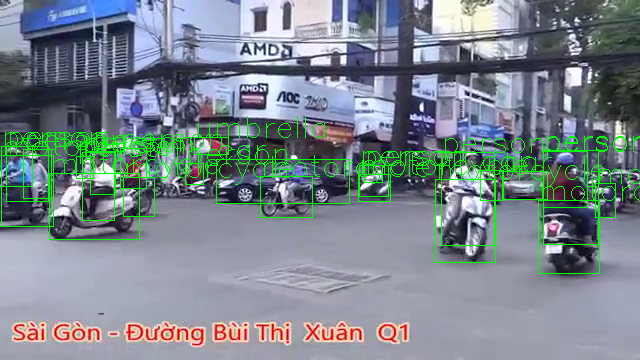

Time on image 17 : 226.853609 ms
22


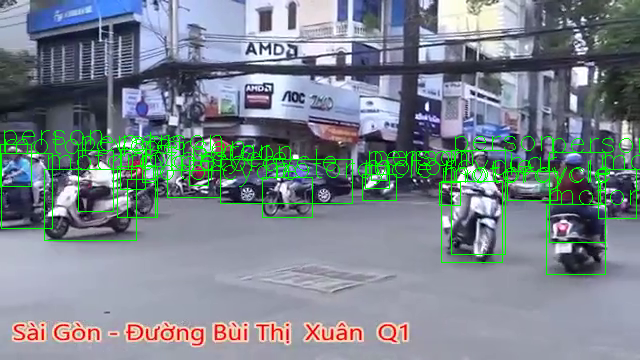

Time on image 18 : 224.659920 ms
21


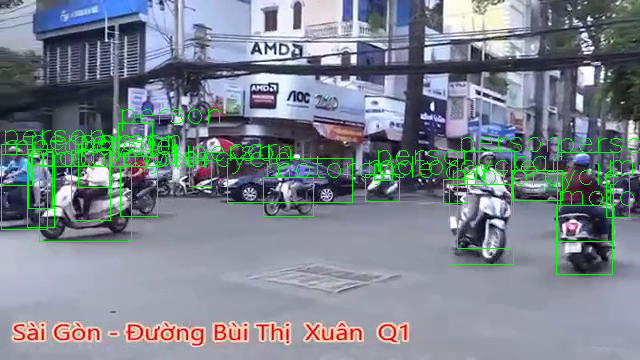

Time on image 19 : 220.627785 ms
25


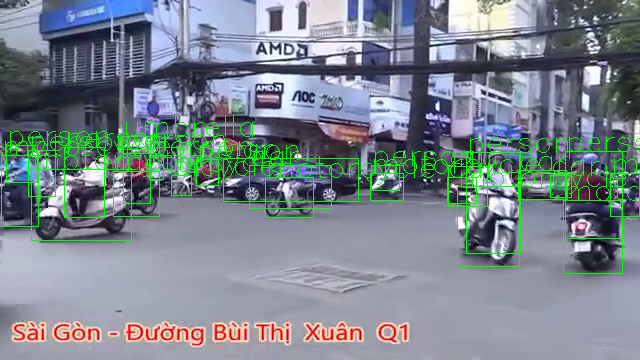

Time on image 20 : 216.083765 ms
25


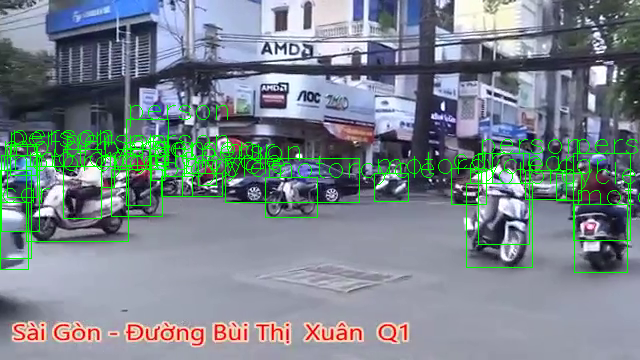

Time on image 21 : 217.548609 ms
25


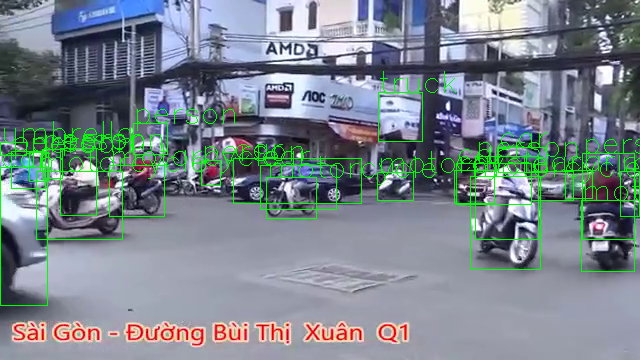

Time on image 22 : 220.728159 ms
26


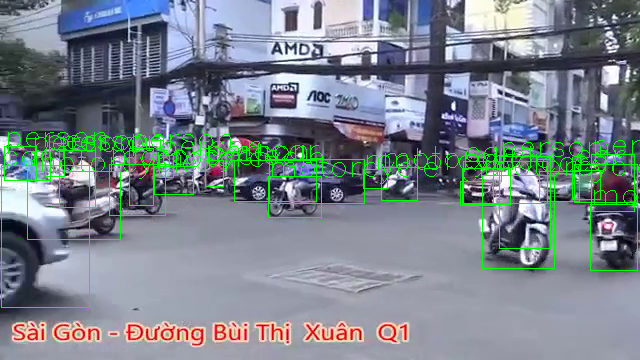

Time on image 23 : 217.275381 ms
26


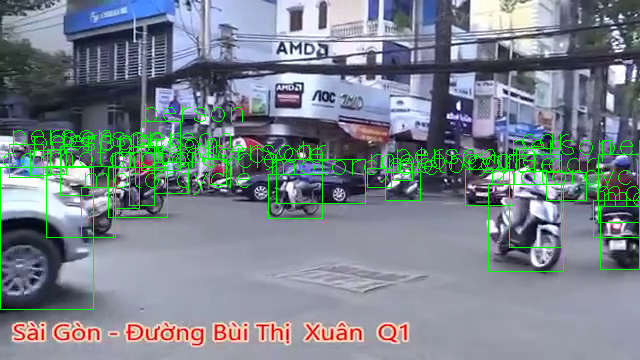

Time on image 24 : 215.201855 ms
20


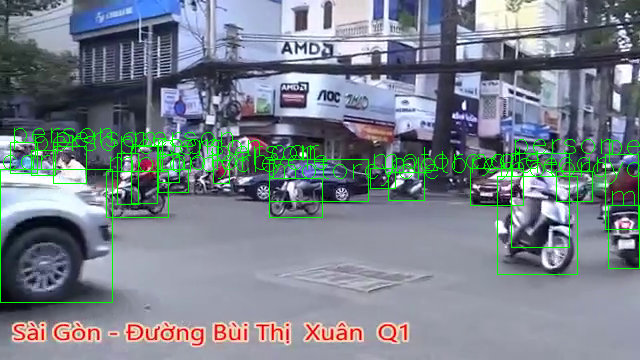

Time on image 25 : 216.079473 ms
23


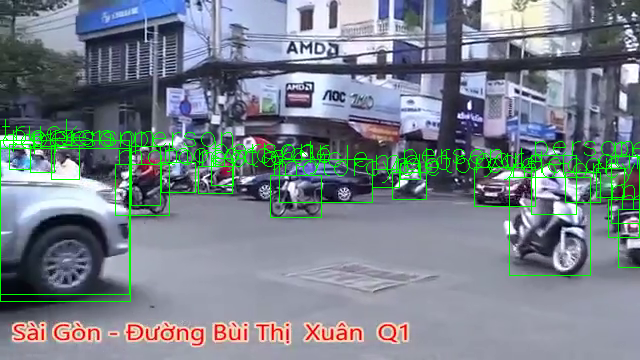

Time on image 26 : 215.298176 ms
24


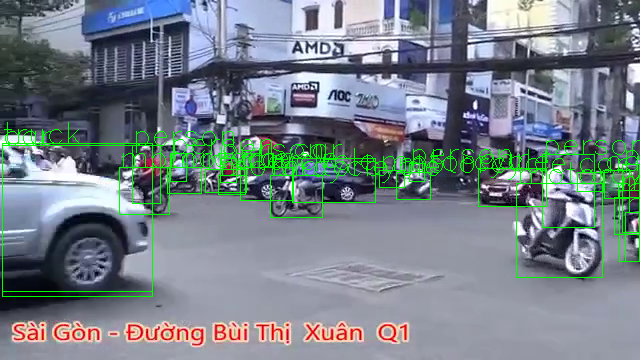

Time on image 27 : 219.611883 ms
19


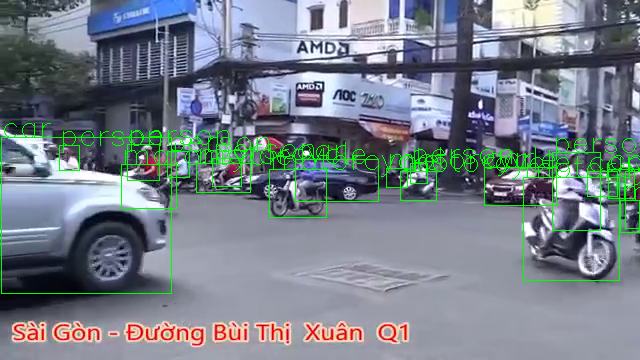

Time on image 28 : 222.294092 ms
14


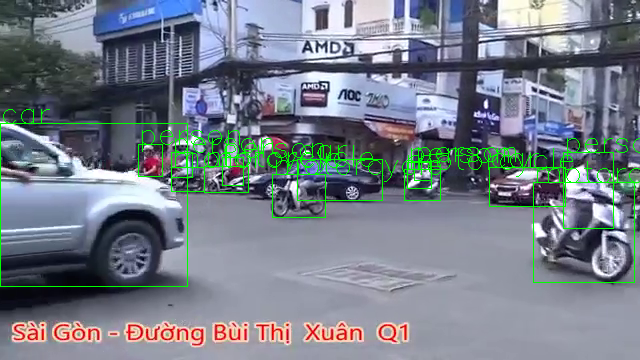

Time on image 29 : 212.290764 ms
12


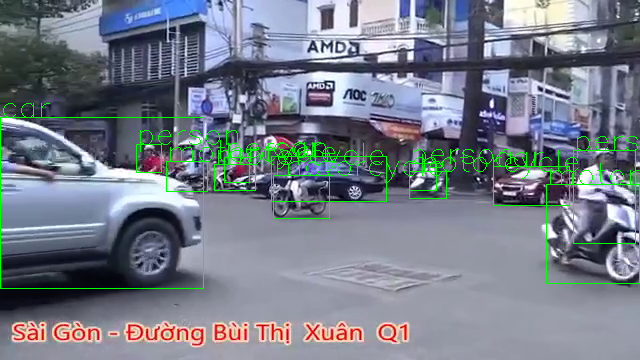

Time on image 30 : 211.393833 ms
19


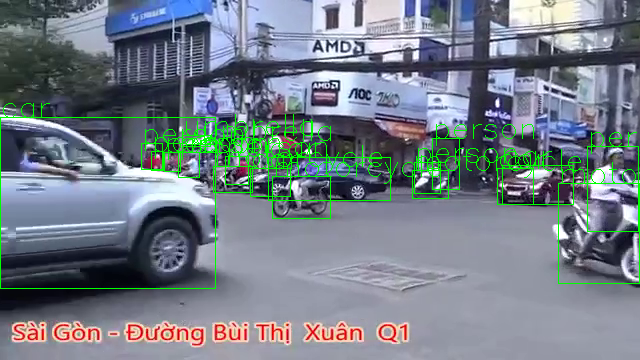

Time on image 31 : 213.169336 ms
16


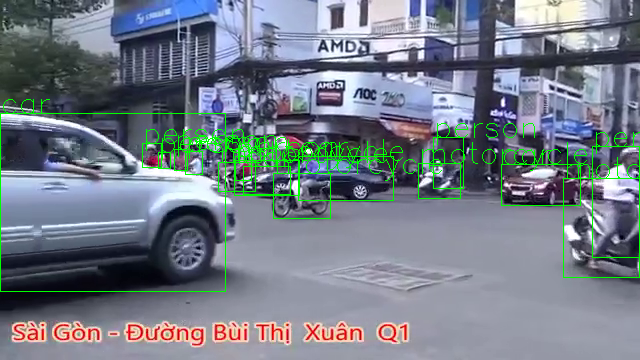

Time on image 32 : 209.385157 ms
16


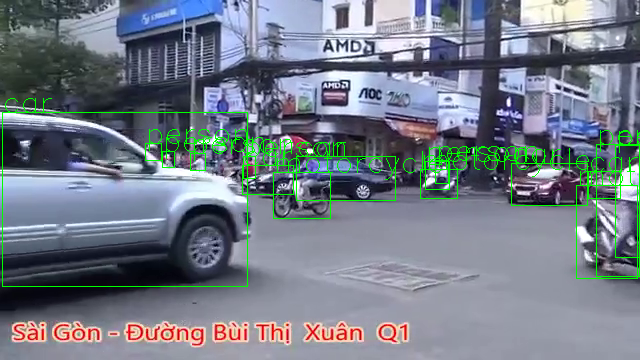

Time on image 33 : 219.532967 ms
15


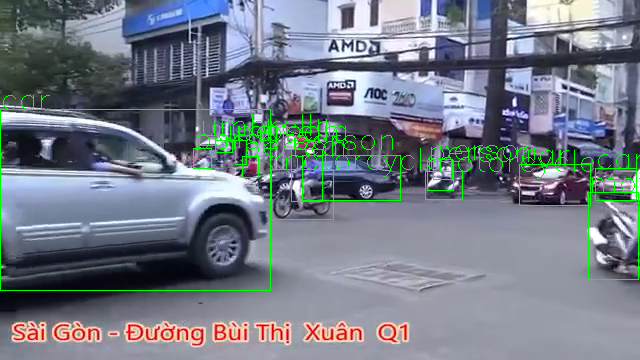

Time on image 34 : 202.894926 ms
17


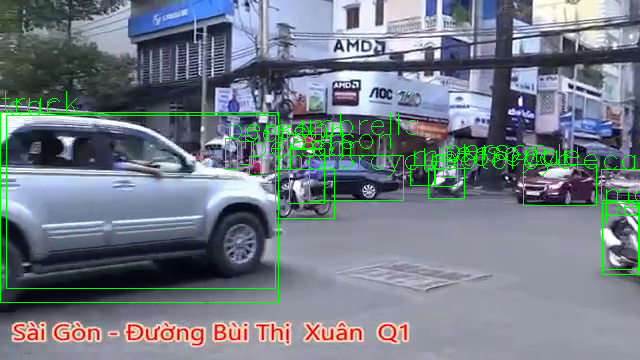

Time on image 35 : 199.119091 ms
16


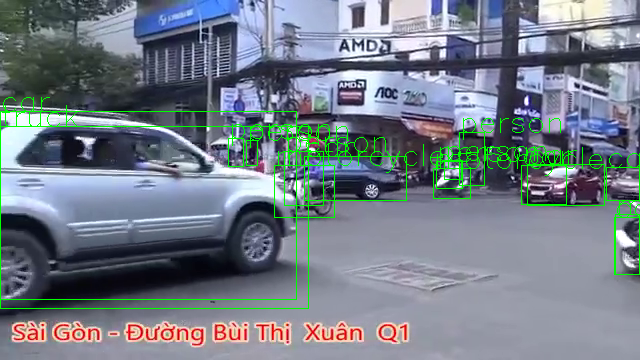

Time on image 36 : 201.972723 ms
13


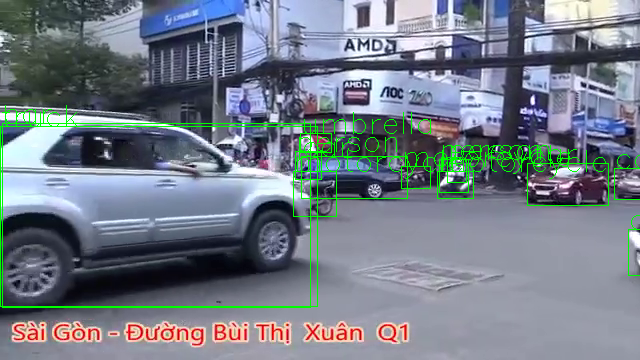

Time on image 37 : 195.525169 ms
13


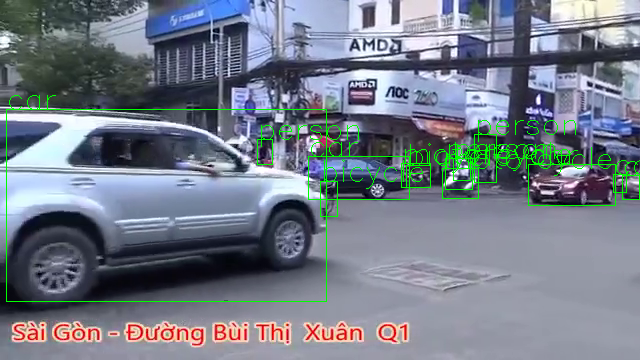

Time on image 38 : 194.388390 ms
7


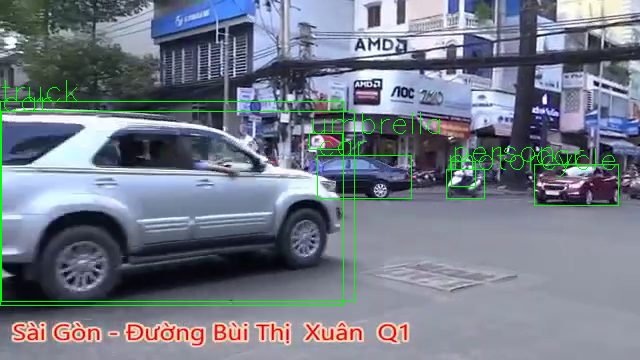

Time on image 39 : 184.108257 ms
8


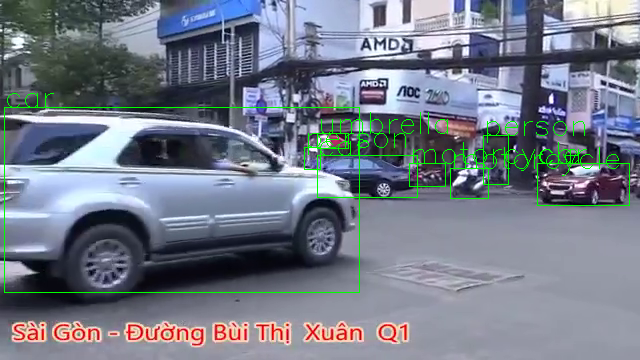

Time on image 40 : 186.719656 ms
6


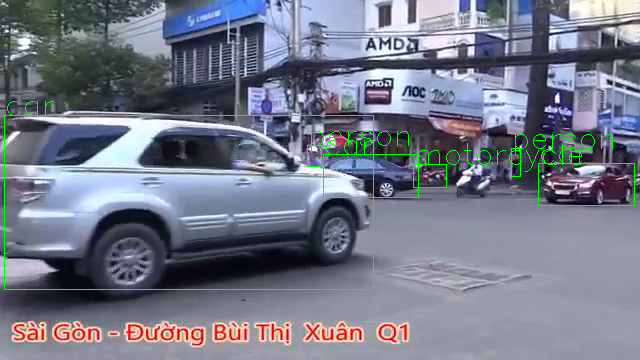

Time on image 41 : 201.061249 ms
7


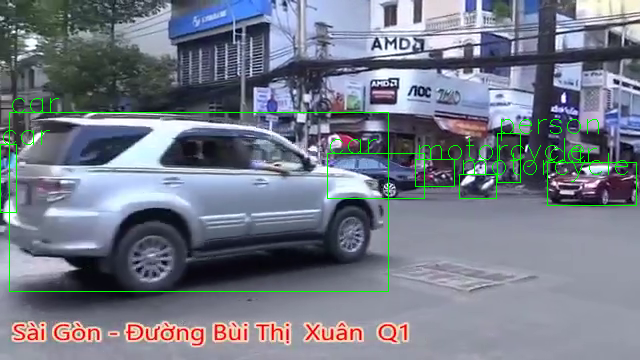

Time on image 42 : 236.924410 ms
8


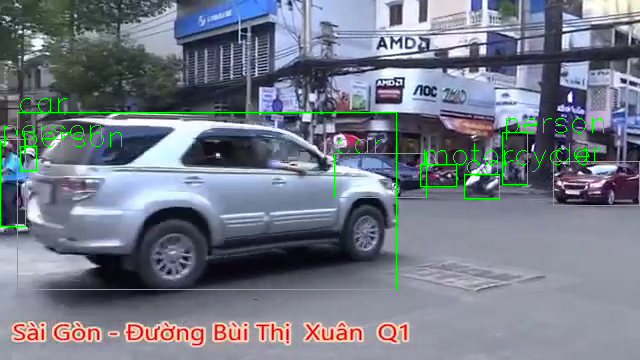

Time on image 43 : 226.744413 ms
8


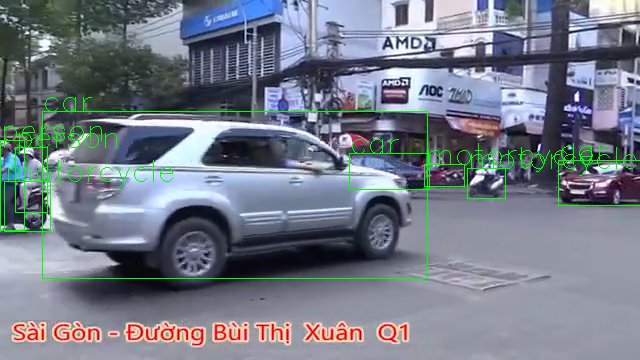

Time on image 44 : 246.124506 ms
13


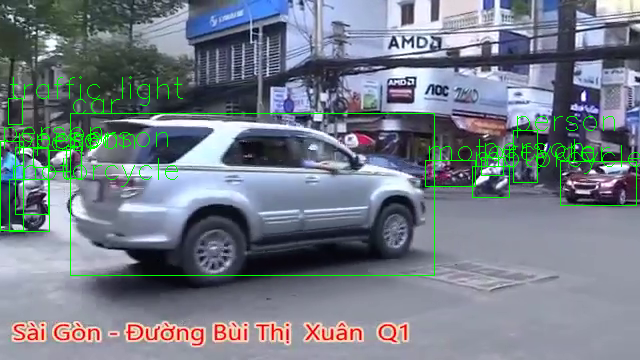

Time on image 45 : 241.014957 ms
14


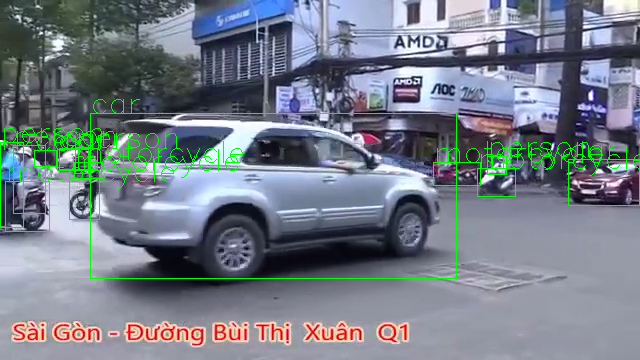

Time on image 46 : 262.634516 ms
19


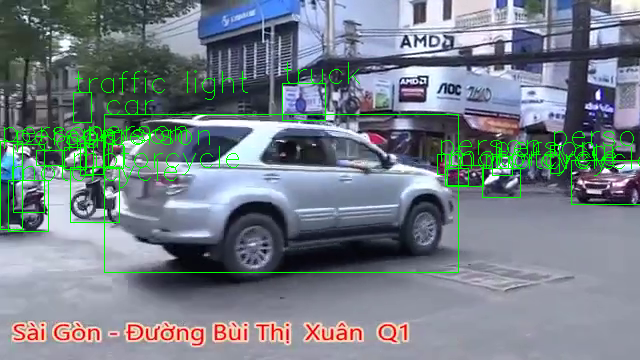

Time on image 47 : 206.657648 ms
14


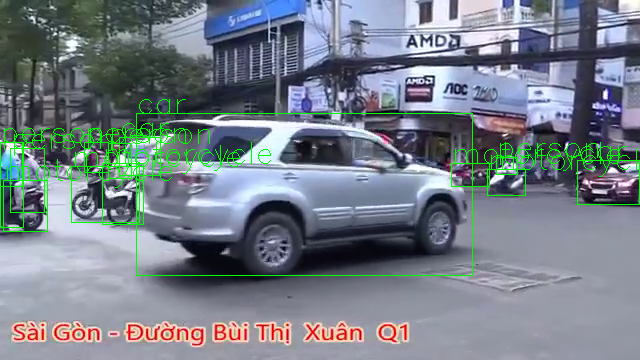

Time on image 48 : 204.927921 ms
18


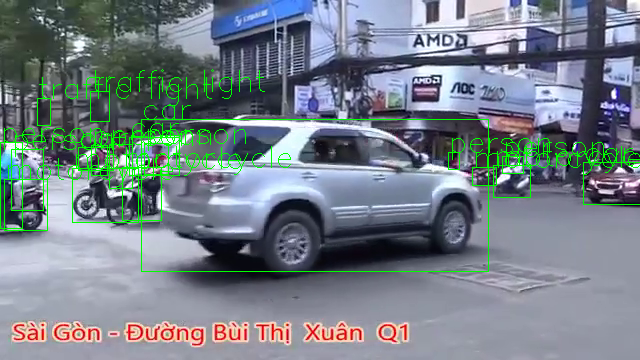

Time on image 49 : 210.398436 ms
18


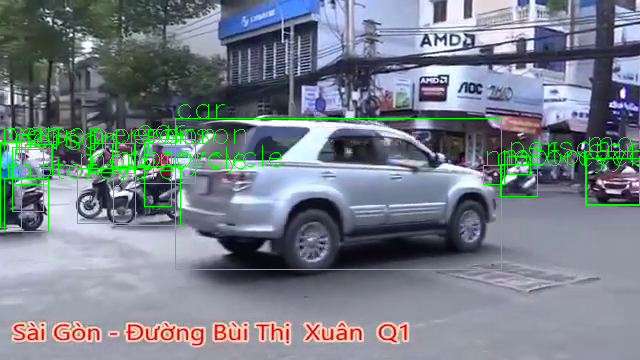

Time on image 50 : 216.053724 ms
14


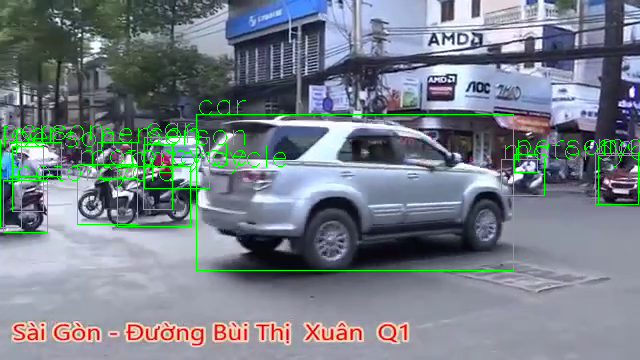

Time on image 51 : 202.627420 ms
15


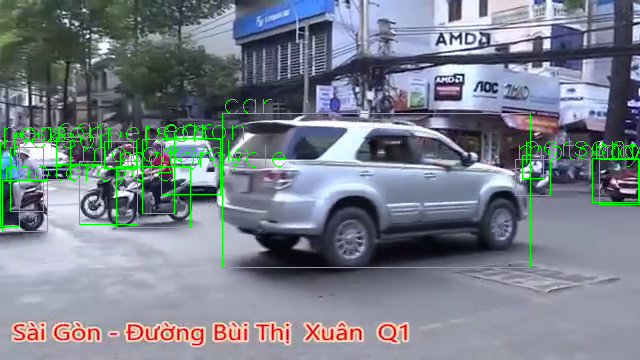

Time on image 52 : 190.420389 ms
14


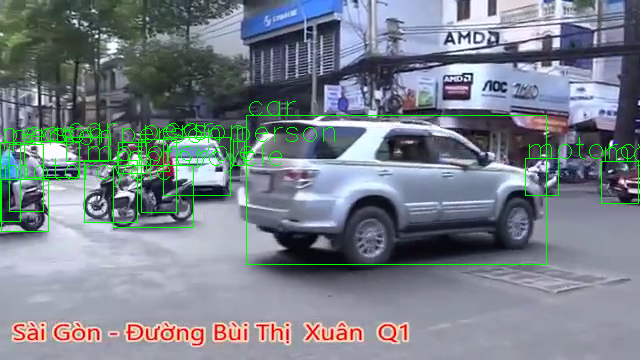

Time on image 53 : 198.580742 ms
12


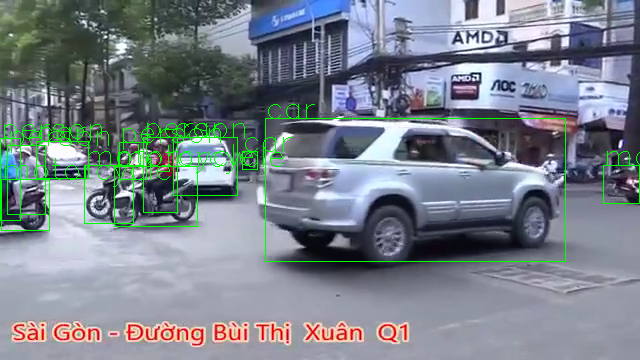

Time on image 54 : 190.425396 ms
16


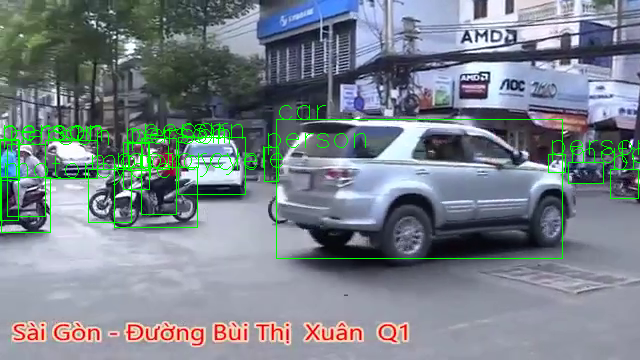

Time on image 55 : 199.766874 ms
14


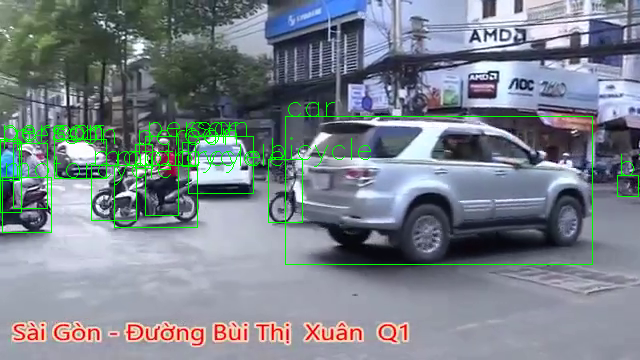

Time on image 56 : 199.905872 ms
13


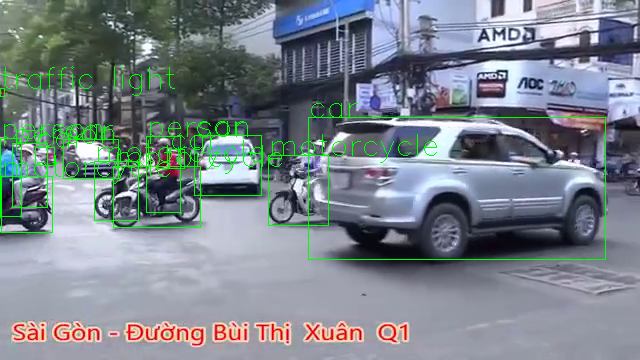

Time on image 57 : 203.685284 ms
18


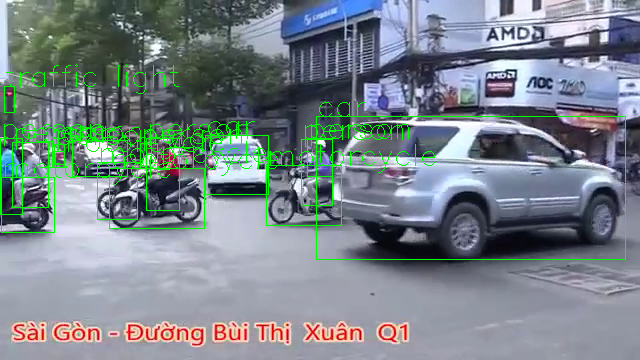

Time on image 58 : 213.510275 ms
19


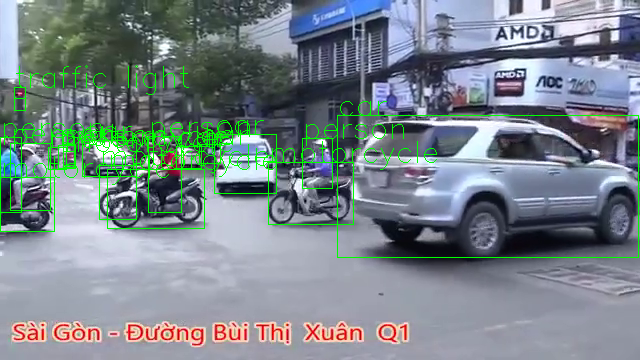

Time on image 59 : 210.166216 ms
18


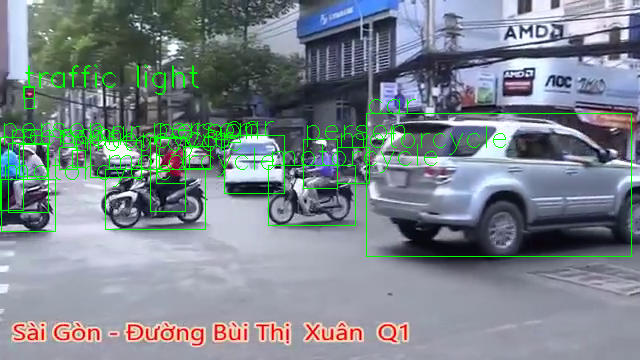

Time on image 60 : 225.816965 ms
22


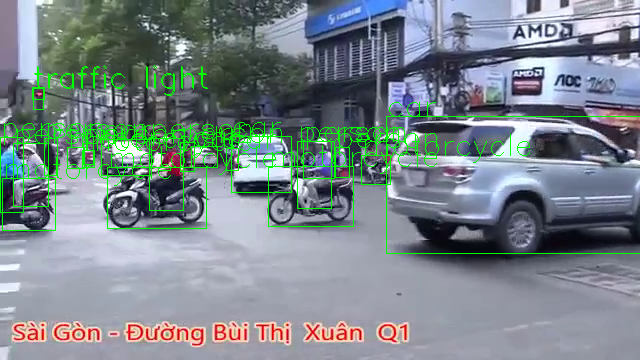

Time on image 61 : 210.365772 ms
22


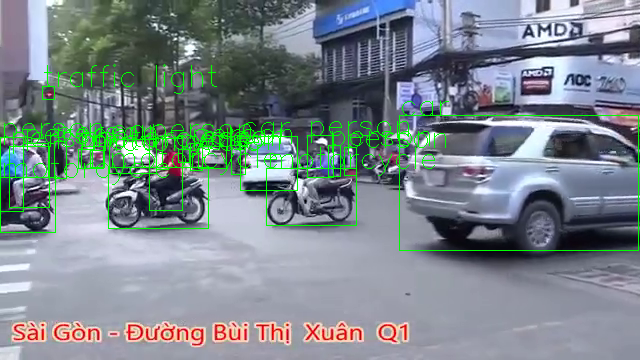

Time on image 62 : 218.883276 ms
25


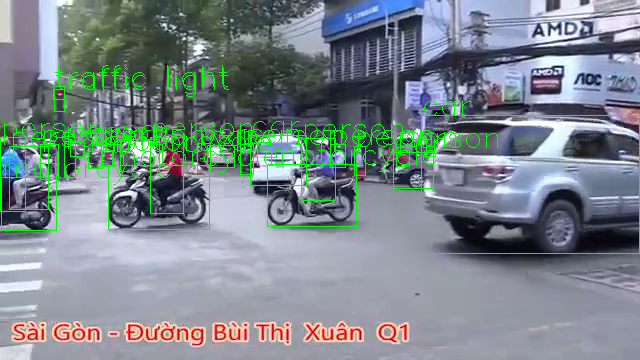

Time on image 63 : 215.647936 ms
24


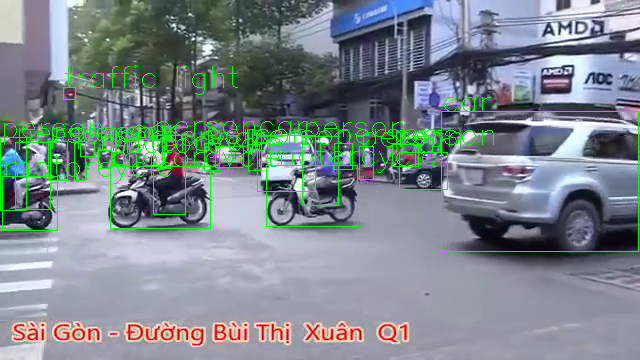

Time on image 64 : 223.017693 ms
27


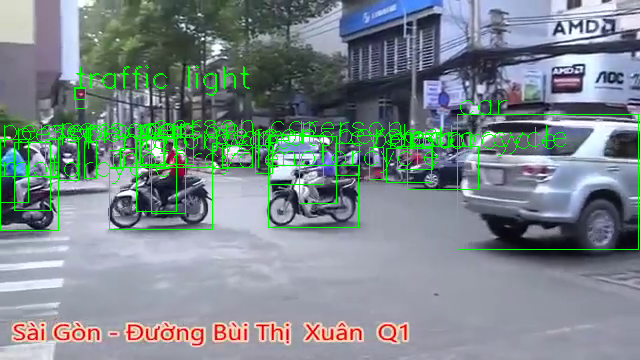

Time on image 65 : 234.552145 ms
25


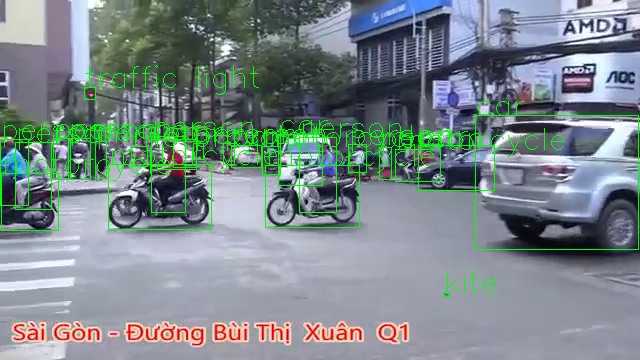

Time on image 66 : 229.089975 ms
25


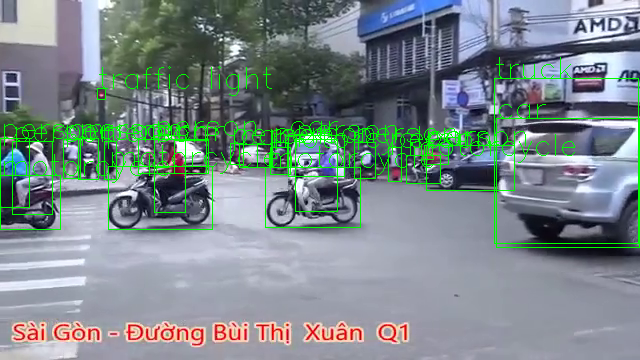

Time on image 67 : 219.369173 ms
31


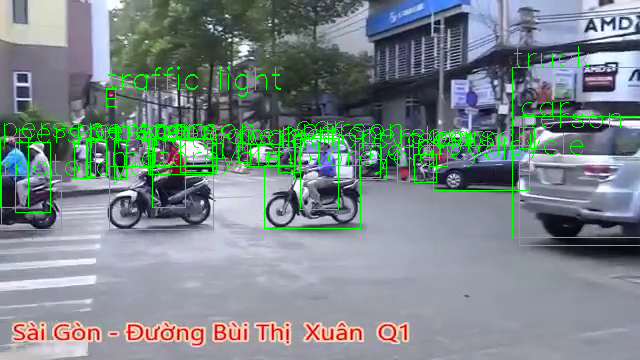

Time on image 68 : 216.861010 ms
23


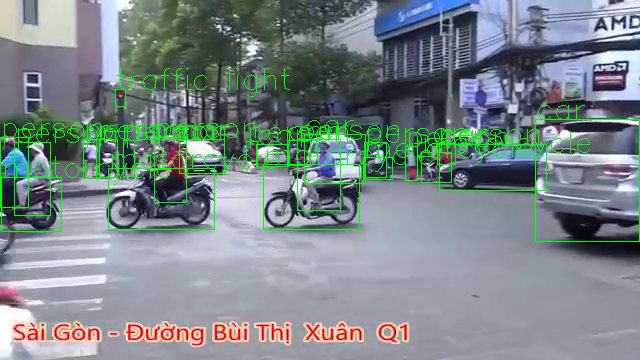

Time on image 69 : 222.017527 ms
28


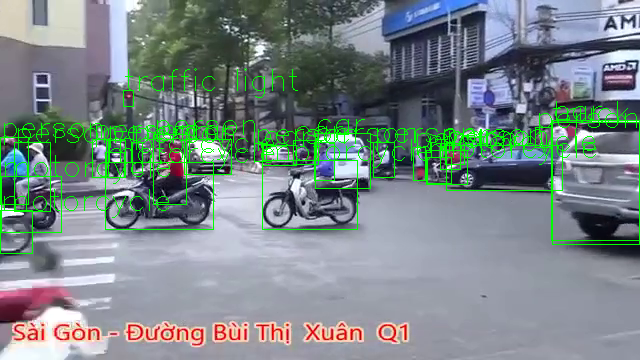

Time on image 70 : 213.861227 ms
27


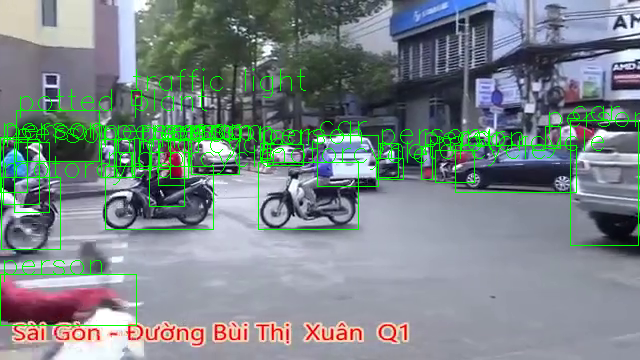

Time on image 71 : 222.923517 ms
26


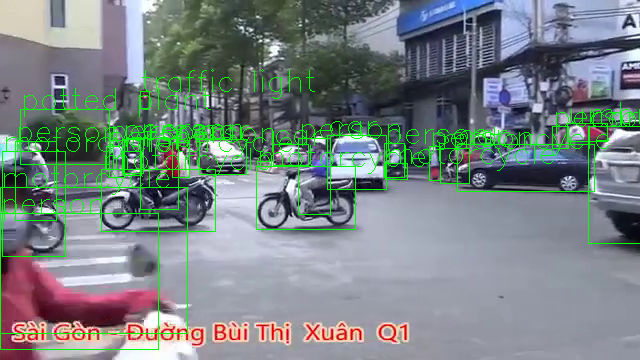

Time on image 72 : 232.015610 ms
25


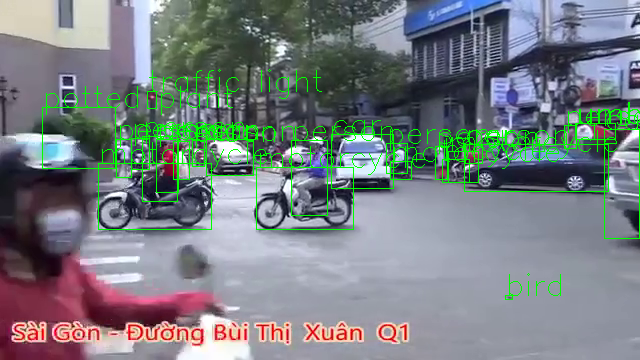

Time on image 73 : 216.900349 ms
24


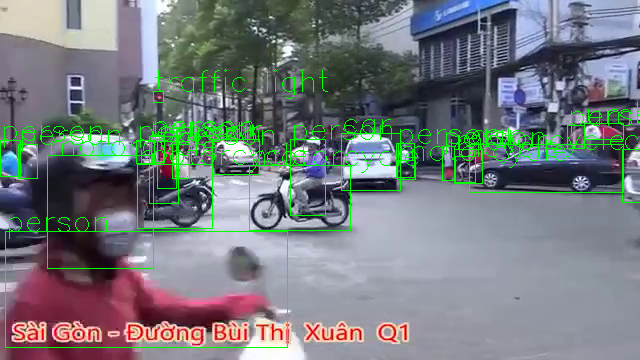

Time on image 74 : 227.793932 ms
23


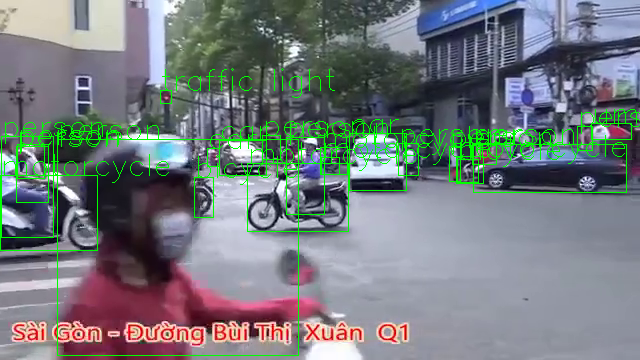

Time on image 75 : 215.550184 ms
21


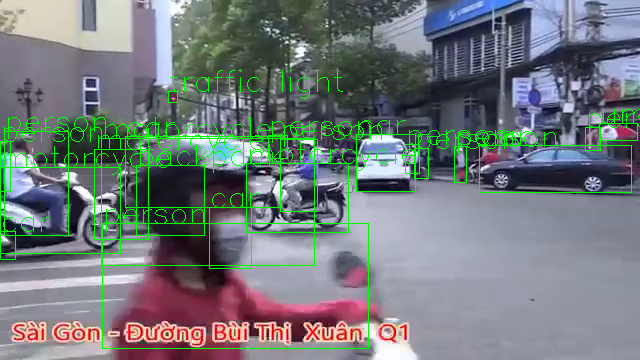

Time on image 76 : 226.207256 ms
28


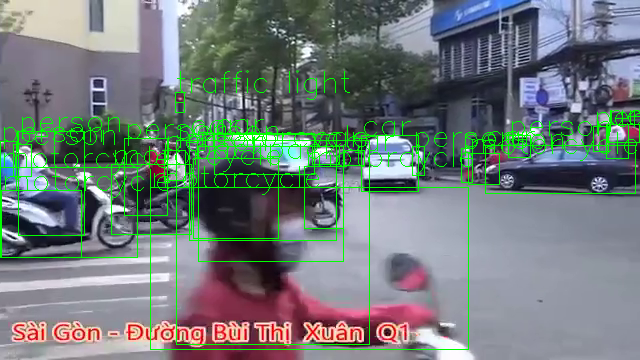

Time on image 77 : 213.294029 ms
29


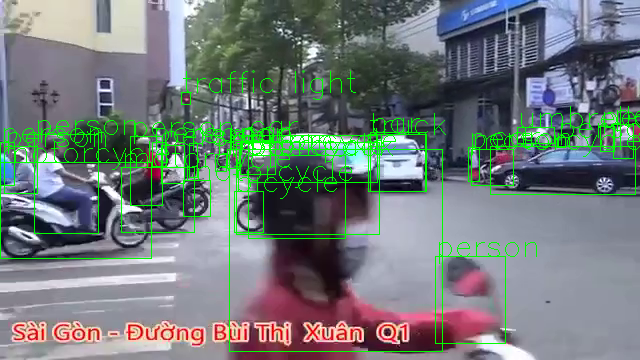

Time on image 78 : 225.398779 ms
28


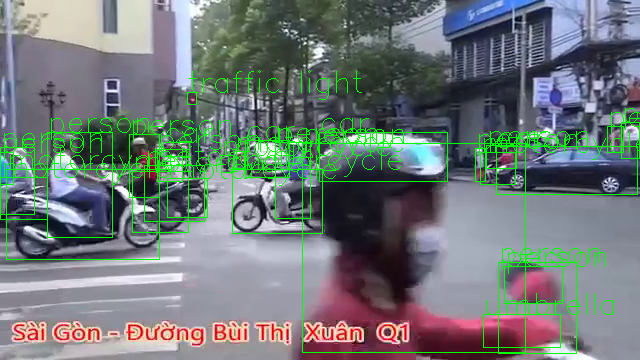

Time on image 79 : 234.291077 ms
28


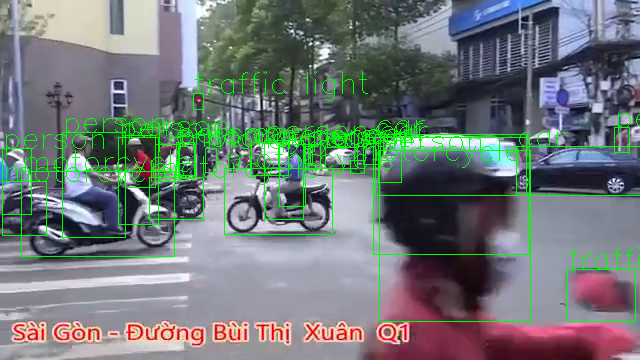

Time on image 80 : 224.202156 ms
25


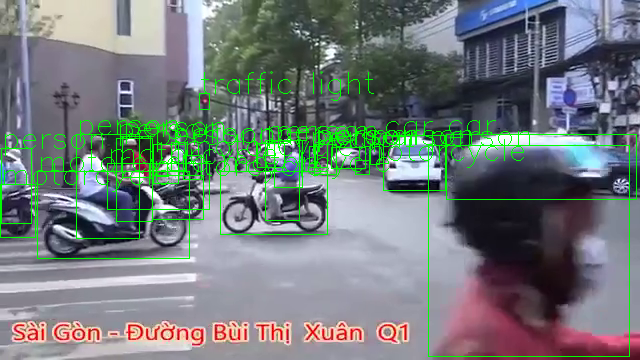

Time on image 81 : 218.145609 ms
30


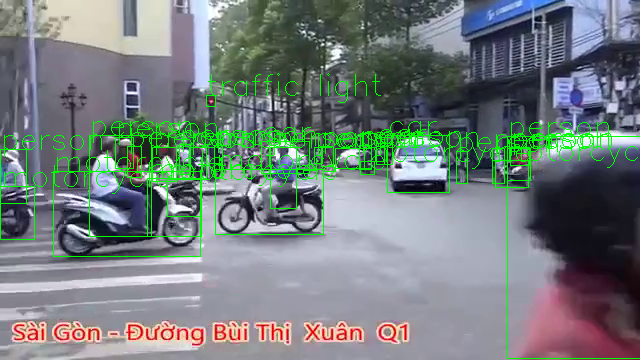

Time on image 82 : 214.610577 ms
30


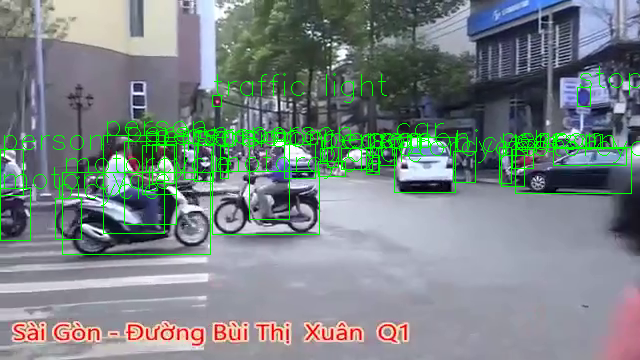

Time on image 83 : 220.476151 ms
26


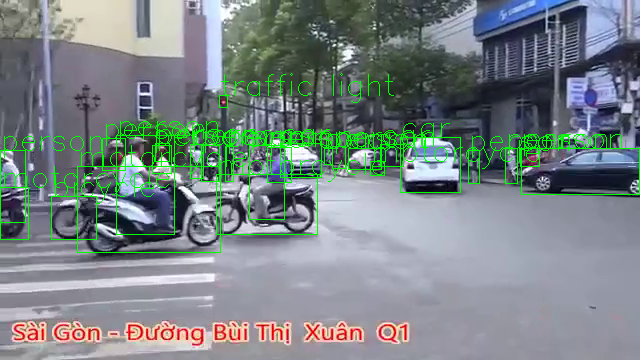

Time on image 84 : 219.582081 ms
23


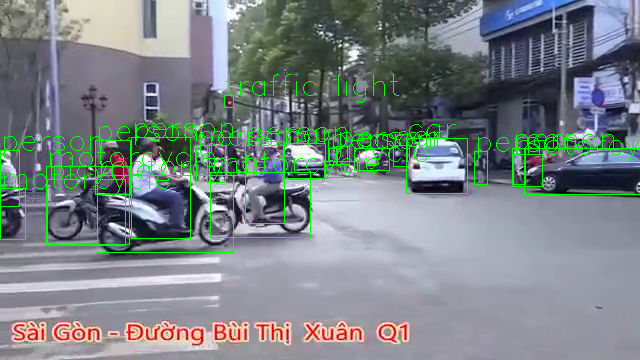

Time on image 85 : 211.961508 ms
22


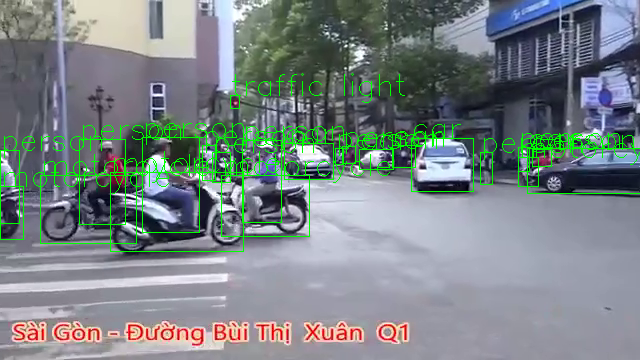

Time on image 86 : 213.447094 ms
25


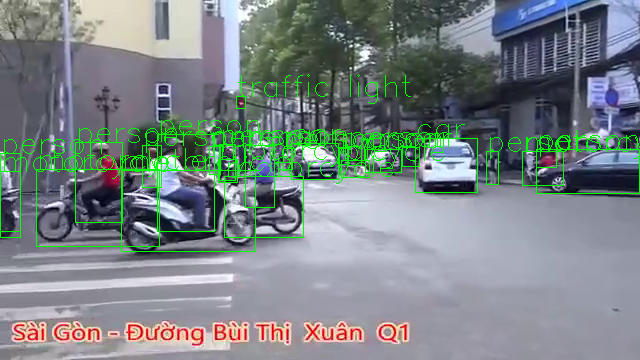

Time on image 87 : 212.491989 ms
28


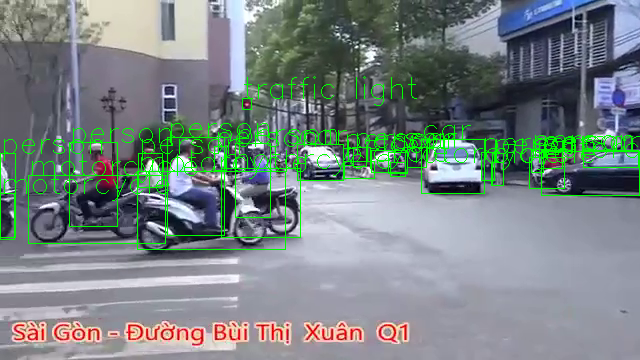

Time on image 88 : 217.367172 ms
23


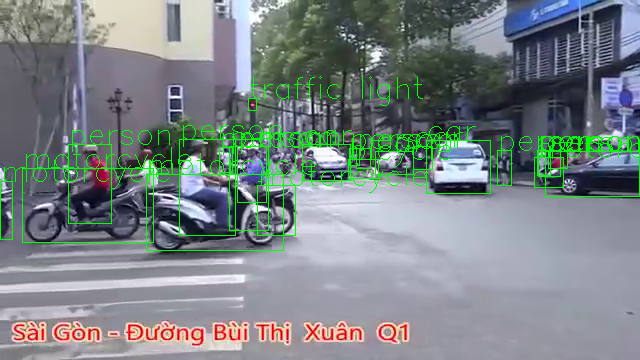

Time on image 89 : 213.354826 ms
24


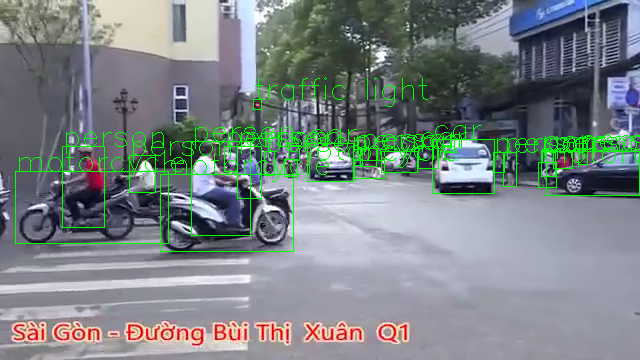

Time on image 90 : 216.558218 ms
21


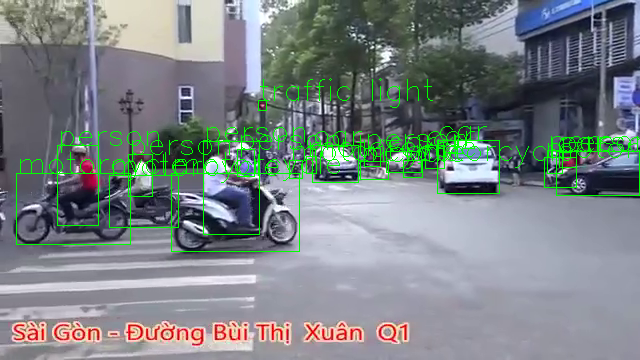

Time on image 91 : 218.145370 ms
23


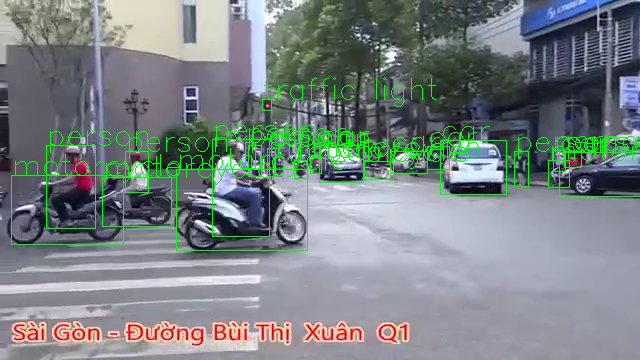

Time on image 92 : 223.993540 ms
20


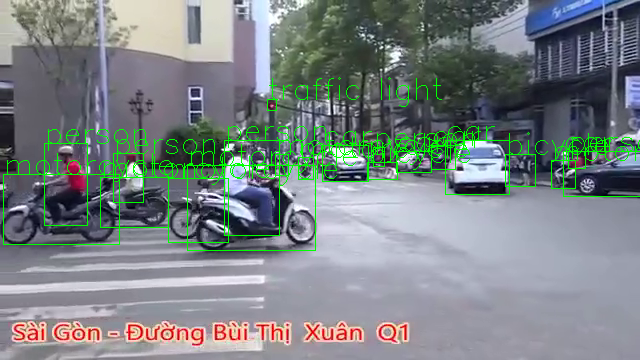

Time on image 93 : 217.540264 ms
22


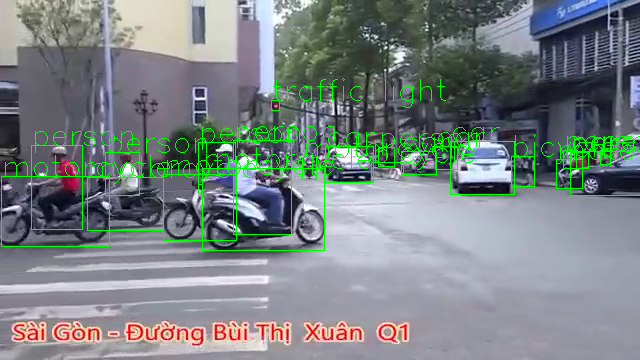

Time on image 94 : 218.204975 ms
21


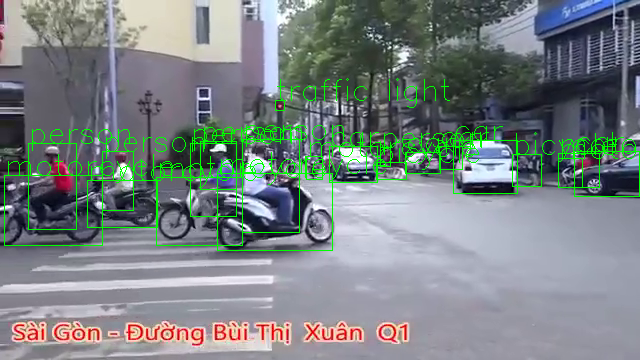

Time on image 95 : 212.695360 ms
21


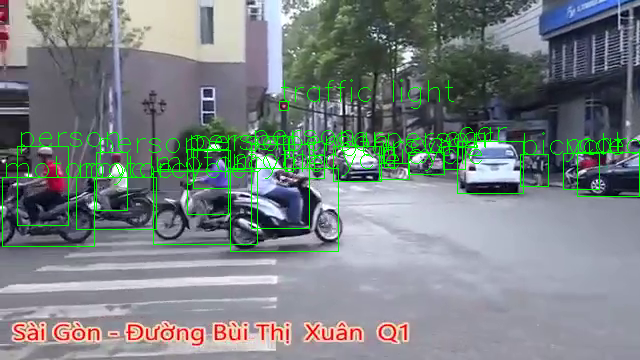

Time on image 96 : 211.961269 ms
21


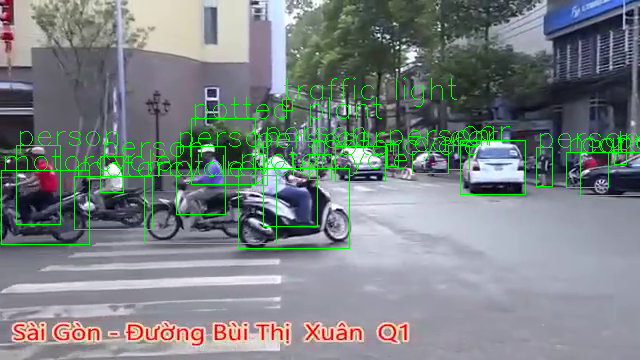

Time on image 97 : 211.593151 ms
20


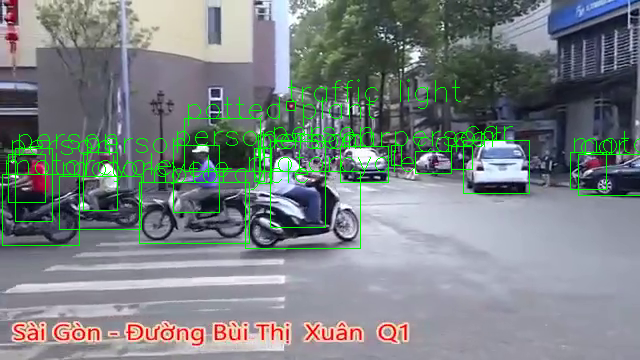

Time on image 98 : 207.267284 ms
23


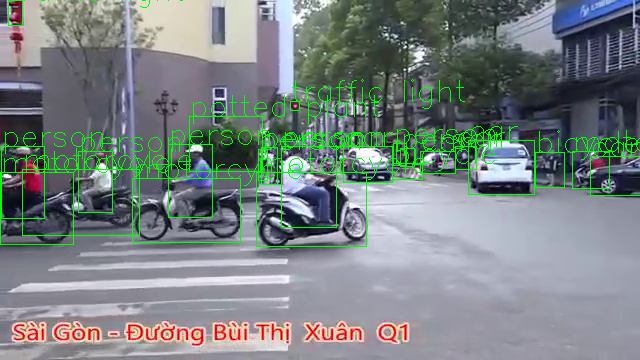

Time on image 99 : 203.517437 ms
Total run-time: 22467.616081 ms


In [92]:
from google.colab.patches import cv2_imshow
i = 0
cap = cv2.VideoCapture(VIDEO_STREAM)
writer = None
cap.set(cv2.CAP_PROP_POS_FRAMES, 15);
start_time = time.time()
while(i<100):
  ret, frame = cap.read()
  start = time.time()
  detection = predict_faster_video(frame, threshold=0.5, gpu=True)
  cv2_imshow(detection)
  end = time.time()
  print ('Time on image',i,': %f ms' % ((end - start) * 1000))
  i = i + 1
  # write on video
  if writer is None:
    # Initialize our video writer
    fourcc = cv2.VideoWriter_fourcc(*"XVID")
    writer = cv2.VideoWriter(VIDEO_STREAM_OUT, fourcc, 30,
      (detection.shape[1], detection.shape[0]), True)
   
  # Write the output frame to disk
  writer.write(detection)
writer.release()
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

## Demo Mask R-CNN



In [69]:
import random
def random_colour_masks(image):
  """
  random_colour_masks
    parameters:
      - image - predicted masks
    method:
      - the masks of each predicted object is given random colour for visualization
  """
  colours = [[0, 255, 0],[0, 0, 255],[255, 0, 0],[0, 255, 255],[255, 255, 0],[255, 0, 255],[80, 70, 180],[250, 80, 190],[245, 145, 50],[70, 150, 250],[50, 190, 190]]
  r = np.zeros_like(image).astype(np.uint8)
  g = np.zeros_like(image).astype(np.uint8)
  b = np.zeros_like(image).astype(np.uint8)
  r[image == 1], g[image == 1], b[image == 1] = colours[random.randrange(0,10)]
  coloured_mask = np.stack([r, g, b], axis=2)
  return coloured_mask

COCO_INSTANCE_CATEGORY_NAMES = [
    '__background__', 'person', 'bicycle', 'car', 'motorcycle', 'airplane', 'bus',
    'train', 'truck', 'boat', 'traffic light', 'fire hydrant', 'N/A', 'stop sign',
    'parking meter', 'bench', 'bird', 'cat', 'dog', 'horse', 'sheep', 'cow',
    'elephant', 'bear', 'zebra', 'giraffe', 'N/A', 'backpack', 'umbrella', 'N/A', 'N/A',
    'handbag', 'tie', 'suitcase', 'frisbee', 'skis', 'snowboard', 'sports ball',
    'kite', 'baseball bat', 'baseball glove', 'skateboard', 'surfboard', 'tennis racket',
    'bottle', 'N/A', 'wine glass', 'cup', 'fork', 'knife', 'spoon', 'bowl',
    'banana', 'apple', 'sandwich', 'orange', 'broccoli', 'carrot', 'hot dog', 'pizza',
    'donut', 'cake', 'chair', 'couch', 'potted plant', 'bed', 'N/A', 'dining table',
    'N/A', 'N/A', 'toilet', 'N/A', 'tv', 'laptop', 'mouse', 'remote', 'keyboard', 'cell phone',
    'microwave', 'oven', 'toaster', 'sink', 'refrigerator', 'N/A', 'book',
    'clock', 'vase', 'scissors', 'teddy bear', 'hair drier', 'toothbrush'
]

colours = [[0, 255, 0],[0, 0, 255],[255, 0, 0],[0, 255, 255],[255, 255, 0],[255, 0, 255],[80, 70, 180],[250, 80, 190],[245, 145, 50],[70, 150, 250],[50, 190, 190]]

a,b,c=colours[0]


In [70]:
def predict_mask(img_path, threshold, gpu):
  img = Image.open(img_path)
  transform = T.Compose([T.ToTensor()])
  img = transform(img)
  if gpu:
    model.cuda()
    img = img.cuda()
  else:
    model.cpu()
    img = img.cpu()
  # prediction
  pred = model([img])
  pred_score = list(pred[0]['scores'].cpu().detach().numpy())
  pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
  masks = (pred[0]['masks']>0.5).squeeze().detach().cpu().numpy()
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].cpu().numpy())]
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].cpu().detach().numpy())]
  masks = masks[:pred_t+1]
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]
  text_size=1
  img = cv2.imread(img_path)
  img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  print (len(pred_boxes))
  for i in range(len(pred_boxes)):
    rgb_mask = random_colour_masks(masks[i])
    img = cv2.addWeighted(img, 1, rgb_mask, 0.5, 0)
    cv2.rectangle(img, pred_boxes[i][0], pred_boxes[i][1],color=(0, 255, 0), thickness=1)
    cv2.putText(img,pred_class[i], pred_boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=1)
  plt.figure(figsize=(20,30))
  plt.imshow(img)
  plt.xticks([])
  plt.yticks([])
  plt.show()

### 2 object

--2020-07-01 09:22:33--  https://truonglaixethegioi.com/wp-content/uploads/2015/08/hoc-lai-xe-o-to-tu-khi-lai-xe-may.jpg
Resolving truonglaixethegioi.com (truonglaixethegioi.com)... 172.96.191.110
Connecting to truonglaixethegioi.com (truonglaixethegioi.com)|172.96.191.110|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 33522 (33K) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>]  32.74K   106KB/s    in 0.3s    

2020-07-01 09:22:35 (106 KB/s) - ‘people.jpg’ saved [33522/33522]



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


5


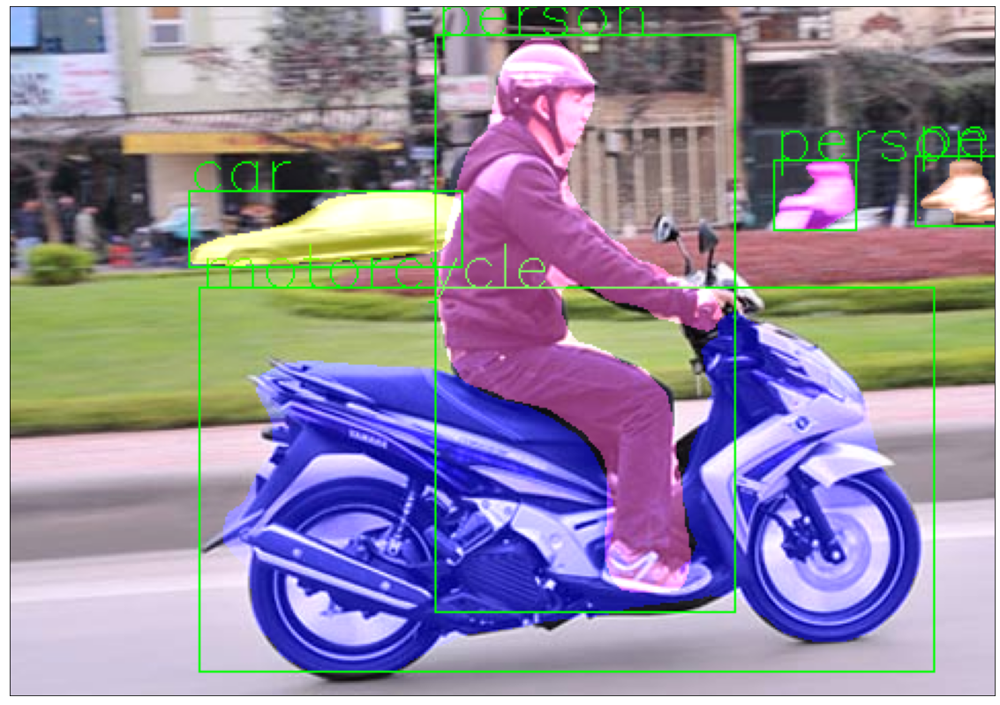

Total run-time: 813.726902 ms


In [71]:
import random

# download an image for inference
!wget https://truonglaixethegioi.com/wp-content/uploads/2015/08/hoc-lai-xe-o-to-tu-khi-lai-xe-may.jpg -O people.jpg

# use the api pipeline for object detection
# the threshold is set manually, the model sometimes predict 
# random structures as some object, so we set a threshold to filter
# better prediction scores.
import time
start_time = time.time()
predict_mask('./people.jpg', 0.9,gpu = True)
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

### 4 object

--2020-07-01 09:23:20--  https://i.a4vn.com/2019/4/27/sinh-vien-ngoai-giao-dua-nhau-khong-di-xe-may-den-truong-ma-di-x-df046f.jpg
Resolving i.a4vn.com (i.a4vn.com)... 123.30.139.27, 123.30.139.26, 123.30.139.42
Connecting to i.a4vn.com (i.a4vn.com)|123.30.139.27|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 116664 (114K) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>] 113.93K   127KB/s    in 0.9s    

2020-07-01 09:23:23 (127 KB/s) - ‘people.jpg’ saved [116664/116664]



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


2


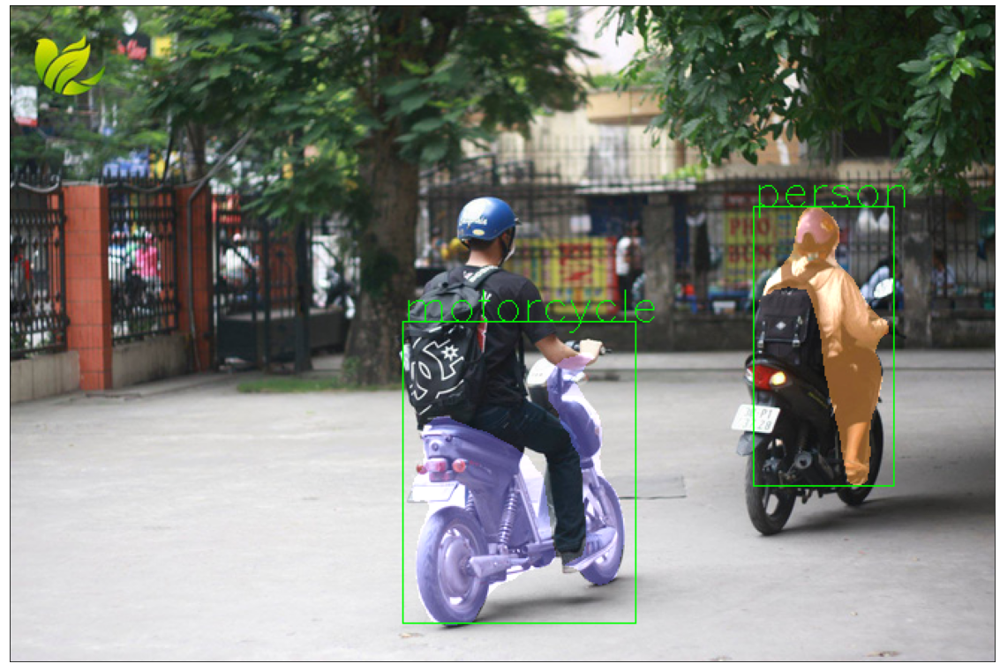

Total run-time: 822.936058 ms


In [72]:
# download an image for inference
!wget https://i.a4vn.com/2019/4/27/sinh-vien-ngoai-giao-dua-nhau-khong-di-xe-may-den-truong-ma-di-x-df046f.jpg -O people.jpg

# use the api pipeline for object detection
# the threshold is set manually, the model sometimes predict 
# random structures as some object, so we set a threshold to filter
# better prediction scores.
import time
start_time = time.time()
predict_mask('./people.jpg', threshold=0.99, gpu = True)
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

### Over 10 object

--2020-07-01 09:23:59--  http://www.baodongnai.com.vn/dataimages/201803/original/images2111009_6E.jpg
Resolving www.baodongnai.com.vn (www.baodongnai.com.vn)... 123.31.45.45
Connecting to www.baodongnai.com.vn (www.baodongnai.com.vn)|123.31.45.45|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 144775 (141K) [image/jpeg]
Saving to: ‘people.jpg’

people.jpg          100%[===================>] 141.38K   156KB/s    in 0.9s    

2020-07-01 09:24:01 (156 KB/s) - ‘people.jpg’ saved [144775/144775]



/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


5


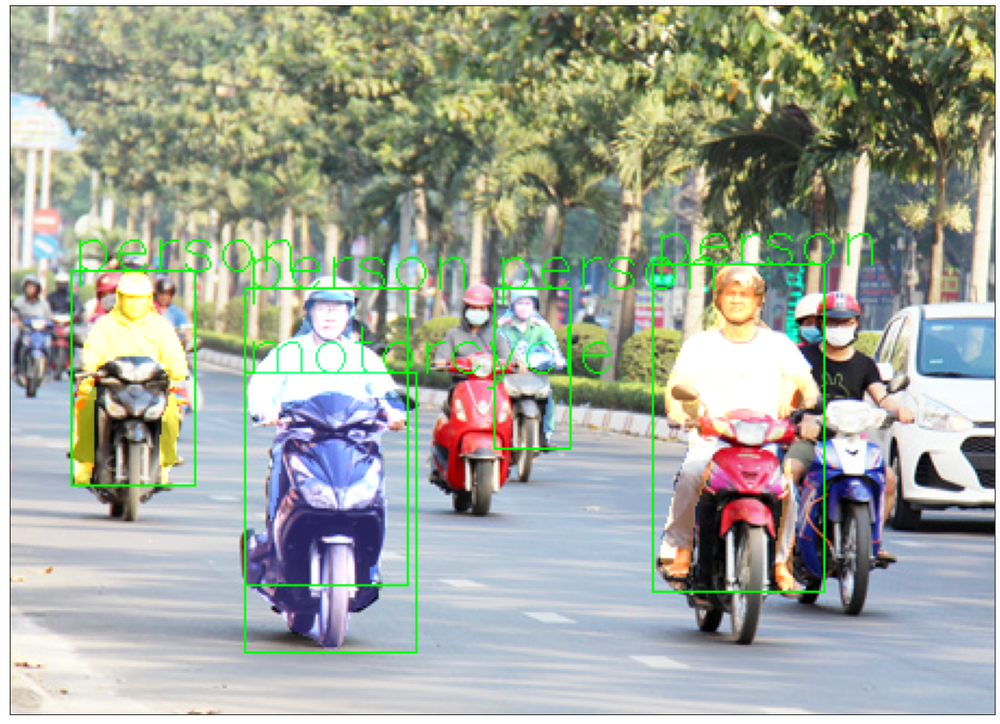

Total run-time: 899.846315 ms


In [73]:
# download an image for inference
!wget http://www.baodongnai.com.vn/dataimages/201803/original/images2111009_6E.jpg -O people.jpg

# use the api pipeline for object detection
# the threshold is set manually, the model sometimes predict 
# random structures as some object, so we set a threshold to filter
# better prediction scores.
import time
start_time = time.time()
predict_mask('./people.jpg', threshold=0.99, gpu = True)
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

### On video

In [86]:
def predict_mask_video(img, threshold, gpu):
  pil_image=Image.fromarray(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
  transform = T.Compose([T.ToTensor()])
  pil_image = transform(pil_image)
  if gpu:
    model.cuda()
    pil_image = pil_image.cuda()
  else:
    model.cpu()
    pil_image = pil_image.cpu()
  # prediction
  pred = model([pil_image])
  pred_score = list(pred[0]['scores'].cpu().detach().numpy())
  pred_t = [pred_score.index(x) for x in pred_score if x>threshold][-1]
  masks = (pred[0]['masks']>0.5).squeeze().detach().cpu().numpy()
  pred_class = [COCO_INSTANCE_CATEGORY_NAMES[i] for i in list(pred[0]['labels'].cpu().numpy())]
  pred_boxes = [[(i[0], i[1]), (i[2], i[3])] for i in list(pred[0]['boxes'].cpu().detach().numpy())]
  masks = masks[:pred_t+1]
  pred_boxes = pred_boxes[:pred_t+1]
  pred_class = pred_class[:pred_t+1]
  text_size=1
  print (len(pred_boxes))
  for i in range(len(pred_boxes)):
    rgb_mask = random_colour_masks(masks[i])
    img = cv2.addWeighted(img, 1, rgb_mask, 0.5, 0)
    cv2.rectangle(img, pred_boxes[i][0], pred_boxes[i][1],color=(0, 255, 0), thickness=1)
    cv2.putText(img,pred_class[i], pred_boxes[i][0], cv2.FONT_HERSHEY_SIMPLEX, text_size, (0,255,0),thickness=1)
  return img

<class 'numpy.ndarray'>
(360, 640, 3)


/usr/local/lib/python3.6/dist-packages/torch/nn/functional.py:2854: UserWarning: The default behavior for interpolate/upsample with float scale_factor will change in 1.6.0 to align with other frameworks/libraries, and use scale_factor directly, instead of relying on the computed output size. If you wish to keep the old behavior, please set recompute_scale_factor=True. See the documentation of nn.Upsample for details. 
  warnings.warn("The default behavior for interpolate/upsample with float scale_factor will change "


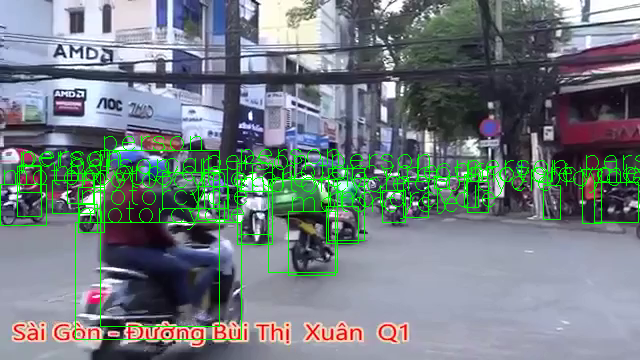

1


In [87]:
from google.colab.patches import cv2_imshow
cap = cv2.VideoCapture('test.mp4')
k = 0
while(k==0):
  ret, frame = cap.read()
  print(type(frame))
  detection = predict_faster_video(frame, threshold=0.5, gpu=True)
  print(detection.shape)
  cv2_imshow(detection)
  k = k+1
  print (k)

In [88]:
VIDEO_STREAM = "/content/drive/My Drive/Colab Notebooks/Detection/test.mp4"
VIDEO_STREAM_OUT = "/content/drive/My Drive/Colab Notebooks/Detection/pre_mask.mp4"

In [89]:
from google.colab.patches import cv2_imshow
i = 0
cap = cv2.VideoCapture(VIDEO_STREAM)
writer = None
cap.set(cv2.CAP_PROP_POS_FRAMES, 15);
start_time = time.time()
while(i<100):
  ret, frame = cap.read()
  start = time.time()
  detection = predict_mask_video(frame, threshold=0.5, gpu=True)
  cv2_imshow(detection)
  end = time.time()
  print ('Time on image',i,': %f ms' % ((end - start) * 1000))
  i = i + 1
  # write on video
  if writer is None:
    # Initialize our video writer
    fourcc = cv2.VideoWriter_fourcc(*"XVID")
    writer = cv2.VideoWriter(VIDEO_STREAM_OUT, fourcc, 30,
      (detection.shape[1], detection.shape[0]), True)
   
  # Write the output frame to disk
  writer.write(detection)
writer.release()
end_time = time.time()
print ('Total run-time: %f ms' % ((end_time - start_time) * 1000))

Output hidden; open in https://colab.research.google.com to view.